In [24]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pickle
from ydata_profiling import ProfileReport

from sklearn.model_selection import train_test_split,cross_val_score, GridSearchCV, RandomizedSearchCV
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.linear_model import LinearRegression, Ridge
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor, VotingRegressor, StackingRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error

In [3]:
df = pd.read_csv('database.csv')  

In [ ]:
profile = ProfileReport(df, title="YData Profiling Report", explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

100%|██████████| 48/48 [00:00<00:00, 173.77it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [4]:
shape = df.shape
columns = df.columns
numerical_columns = df.select_dtypes(include=['number']).columns.tolist()
categorical_columns = df.select_dtypes(include=['object', 'category']).columns.tolist()

print("Shape:", shape)
print("\nColumns:", columns)
print("\nNumerical Columns:", numerical_columns)
print("\nCategorical Columns:", categorical_columns)

Shape: (2795, 48)

Columns: Index(['Report Number', 'Supplemental Number', 'Accident Year',
       'Accident Date/Time', 'Operator ID', 'Operator Name',
       'Pipeline/Facility Name', 'Pipeline Location', 'Pipeline Type',
       'Liquid Type', 'Liquid Subtype', 'Liquid Name', 'Accident City',
       'Accident County', 'Accident State', 'Accident Latitude',
       'Accident Longitude', 'Cause Category', 'Cause Subcategory',
       'Unintentional Release (Barrels)', 'Intentional Release (Barrels)',
       'Liquid Recovery (Barrels)', 'Net Loss (Barrels)', 'Liquid Ignition',
       'Liquid Explosion', 'Pipeline Shutdown', 'Shutdown Date/Time',
       'Restart Date/Time', 'Public Evacuations', 'Operator Employee Injuries',
       'Operator Contractor Injuries', 'Emergency Responder Injuries',
       'Other Injuries', 'Public Injuries', 'All Injuries',
       'Operator Employee Fatalities', 'Operator Contractor Fatalities',
       'Emergency Responder Fatalities', 'Other Fatalities',
    

In [5]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Report Number,2795.0,2.013293e+07,1.982098e+04,2.010000e+07,2.012004e+07,2.013037e+07,2.015023e+07,2.017003e+07
Supplemental Number,2795.0,1.943332e+04,1.724815e+03,1.507200e+04,1.797850e+04,1.950200e+04,2.099650e+04,2.204900e+04
Accident Year,2795.0,2.013188e+03,1.972102e+00,2.010000e+03,2.012000e+03,2.013000e+03,2.015000e+03,2.017000e+03
Operator ID,2795.0,2.138848e+04,1.243097e+04,3.000000e+02,1.116900e+04,2.604100e+04,3.161800e+04,9.904300e+04
Accident Latitude,2795.0,3.578161e+01,5.652599e+00,1.844801e+01,3.090938e+01,3.492544e+01,4.026406e+01,7.026126e+01
Accident Longitude,2795.0,-9.568269e+01,1.232843e+01,-1.580999e+02,-1.005876e+02,-9.548887e+01,-9.108946e+01,1.042634e+02
Unintentional Release (Barrels),2795.0,2.072458e+02,1.368668e+03,0.000000e+00,4.800000e-01,2.000000e+00,2.000000e+01,3.056500e+04
Intentional Release (Barrels),1209.0,2.385336e+02,2.781771e+03,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,7.019100e+04
Liquid Recovery (Barrels),2795.0,7.505179e+01,5.461882e+02,0.000000e+00,0.000000e+00,7.400000e-01,8.000000e+00,1.824500e+04
Net Loss (Barrels),2795.0,1.321941e+02,1.185019e+03,0.000000e+00,0.000000e+00,0.000000e+00,2.000000e+00,3.056500e+04


In [6]:
df.isnull().sum().sort_values(ascending=False)

Public Fatalities                       2787
All Fatalities                          2787
Operator Employee Fatalities            2787
Other Fatalities                        2787
Emergency Responder Fatalities          2787
Operator Contractor Fatalities          2787
Operator Employee Injuries              2783
Emergency Responder Injuries            2783
Public Injuries                         2783
Operator Contractor Injuries            2783
Other Injuries                          2783
All Injuries                            2783
Liquid Name                             2573
Intentional Release (Barrels)           1586
Restart Date/Time                       1454
Liquid Subtype                          1446
Shutdown Date/Time                      1405
Public Evacuations                       457
Accident City                            315
Pipeline Shutdown                        212
Pipeline/Facility Name                   121
Accident County                           75
Pipeline T

In [16]:
selected_features = [
    'Pipeline Type', 
    'Liquid Type', 
    'Accident State', 
    'Accident Latitude', 
    'Accident Longitude', 
    'Cause Category', 
    'Cause Subcategory', 
    'Liquid Recovery (Barrels)', 
    'Pipeline Shutdown'
]
target = 'Unintentional Release (Barrels)'

df = df.dropna(subset=[target])

X = df[selected_features]
y = df[target]

X.isnull().sum()

Pipeline Type                 18
Liquid Type                    0
Accident State                12
Accident Latitude              0
Accident Longitude             0
Cause Category                 0
Cause Subcategory              0
Liquid Recovery (Barrels)      0
Pipeline Shutdown            212
dtype: int64

In [22]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

print(f"Training shape: {X_train.shape}")
print(f"Testing shape: {X_test.shape}")

Training shape: (2236, 9)
Testing shape: (559, 9)


In [25]:
numeric_features = ['Accident Latitude', 'Accident Longitude', 'Liquid Recovery (Barrels)']
categorical_features = ['Pipeline Type', 'Liquid Type', 'Accident State', 'Cause Category', 'Cause Subcategory', 'Pipeline Shutdown']

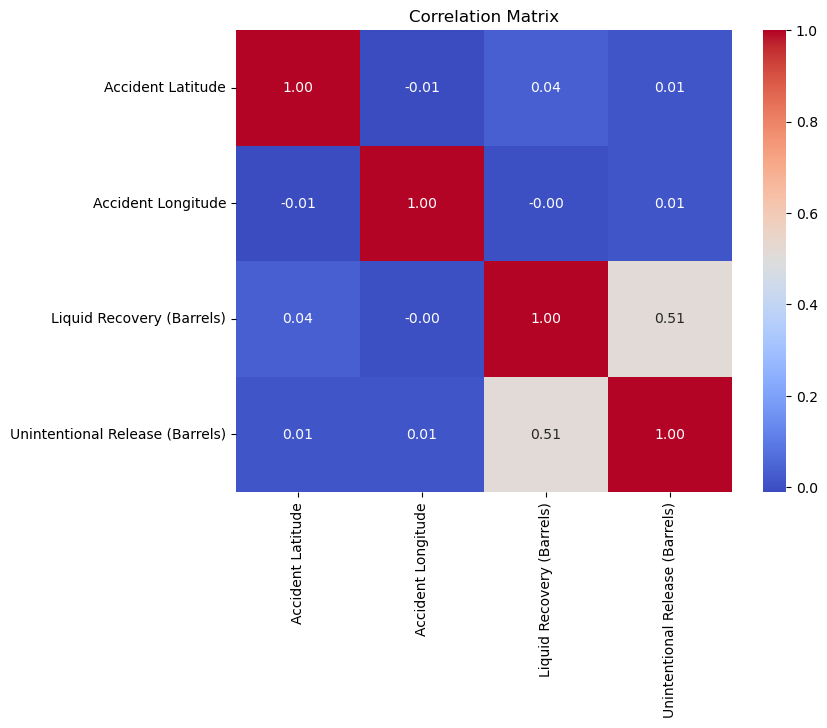

In [50]:
corr = df[numeric_features + [target]].corr()
plt.figure(figsize=(8, 6))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('Correlation Matrix')
plt.show()

In [26]:
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())
])

categorical_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='most_frequent')),
    ('onehot', OneHotEncoder(handle_unknown='ignore'))
])

preprocessor = ColumnTransformer(
    transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)
    ])

In [33]:
models = [
    ('Linear Regression', LinearRegression()),
    ('Ridge', Ridge()),
    ('Random Forest', RandomForestRegressor(random_state=42)),
    ('Gradient Boosting', GradientBoostingRegressor(random_state=42))
]

results = []

for name, model in models:
    clf = Pipeline(steps=[('preprocessor', preprocessor),
                          ('model', model)])
    
    cv_scores = cross_val_score(clf, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
    
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)
    
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    r2 = r2_score(y_test, y_pred)
    cv_rsme = np.sqrt(-cv_scores).mean()
    
    results.append({
        'Model': name,
        'CV Mean RMSE': cv_rsme,
        'Test MAE': mae,
        'Test RMSE': rmse,
        'Test R2': r2
    })
    
    print(f"{name}: CV RMSE={cv_rsme:.2f}, RMSE={rmse:.2f}, R2={r2:.4f}")

Linear Regression: CV RMSE=985.66, RMSE=1253.64, R2=0.5352
Ridge: CV RMSE=981.98, RMSE=1408.82, R2=0.4130
Random Forest: CV RMSE=1034.60, RMSE=1607.85, R2=0.2354
Gradient Boosting: CV RMSE=1081.58, RMSE=1421.81, R2=0.4021


In [34]:
estimators = [
    ('rf', RandomForestRegressor(n_estimators=50, random_state=42)),
    ('gb', GradientBoostingRegressor(random_state=42)),
    ('ridge', Ridge())
]

voting_reg = VotingRegressor(estimators=estimators)
voting_pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('voting', voting_reg)])

stacking_reg = StackingRegressor(
    estimators=estimators,
    final_estimator=LinearRegression()
)
stacking_pipeline = Pipeline(steps=[('preprocessor', preprocessor), ('stacking', stacking_reg)])

ensemble_models = [
    ('Voting Regressor', voting_pipeline),
    ('Stacking Regressor', stacking_pipeline)
]

for name, pipeline in ensemble_models:
    cv_scores = cross_val_score(pipeline, X_train, y_train, cv=5, scoring='neg_mean_squared_error')

    pipeline.fit(X_train, y_train)
    y_pred = pipeline.predict(X_test)

    r2 = r2_score(y_test, y_pred)
    mae = mean_absolute_error(y_test, y_pred)
    rmse = np.sqrt(mean_squared_error(y_test, y_pred))
    cv_rsme = np.sqrt(-cv_scores).mean()


    results.append({
        'Model': name,
        'CV Mean RMSE': cv_rsme,
        'Test MAE': mae,
        'Test RMSE': rmse,
        'Test R2': r2
    })

    print(f"{name}: CV RMSE={cv_rsme:.2f}, RMSE={rmse:.2f}, R2={r2:.4f}")


Voting Regressor: CV RMSE=997.30, RMSE=1393.39, R2=0.4258
Stacking Regressor: CV RMSE=982.03, RMSE=1385.79, R2=0.4320


In [35]:
results_df = pd.DataFrame(results)
results_df.sort_values(by='Test RMSE')

,Model,CV Mean RMSE,Test MAE,Test RMSE,Test R2
0,Linear Regression,985.660019,319.733196,1253.643532,0.535186
5,Stacking Regressor,982.033963,296.710019,1385.788136,0.432031
4,Voting Regressor,997.299480,276.986730,1393.391535,0.425782
1,Ridge,981.976627,339.953004,1408.821296,0.412994
3,Gradient Boosting,1081.575160,272.125691,1421.806755,0.402123
2,Random Forest,1034.597084,278.231781,1607.847785,0.235424


In [39]:
randomized_rf_pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                              ('regressor', RandomForestRegressor(random_state=42))])

param_grid = {
    'regressor__n_estimators': [100, 200, 300],
    'regressor__max_depth': [None, 10, 20, 30],
    'regressor__min_samples_split': [2, 5, 10],
    'regressor__min_samples_leaf': [1, 2, 4]
}

search = RandomizedSearchCV(
    randomized_rf_pipeline, 
    param_grid, 
    n_iter=20,
    cv=3, 
    scoring='neg_mean_squared_error', 
    n_jobs=-1, 
    random_state=42,
    verbose=1
)

randomized_rf_cv_scores = cross_val_score(randomized_rf_pipeline, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
randomized_rf_cv_rsme = np.sqrt(-randomized_rf_cv_scores).mean()

search.fit(X_train, y_train)

print(f"Best Parameters: {search.best_params_}")
print(f"Best CV Score (Negative MSE): {search.best_score_}")


Fitting 3 folds for each of 20 candidates, totalling 60 fits
Best Parameters: {'regressor__n_estimators': 300, 'regressor__min_samples_split': 10, 'regressor__min_samples_leaf': 1, 'regressor__max_depth': 20}
Best CV Score (Negative MSE): -1160205.3465567667


In [41]:
rf_randomized = search.best_estimator_
y_pred_randomized = rf_randomized.predict(X_test)

randomized_rf_mae = mean_absolute_error(y_test, y_pred_randomized)
randomized_rf_mse = mean_squared_error(y_test, y_pred_randomized)
randomized_rf_rmse = np.sqrt(randomized_rf_mse)
randomized_rf_r2 = r2_score(y_test, y_pred_randomized)

results.append({
    'Model': 'Randomized Search RF',
    'CV Mean RMSE': randomized_rf_cv_rsme,
    'Test MAE': randomized_rf_mae,
    'Test RMSE': randomized_rf_rmse,
    'Test R2': randomized_rf_r2
})

print(f"Randomized Search RF: CV RMSE={randomized_rf_cv_rsme:.2f}, RMSE={randomized_rf_rmse:.2f}, R2={randomized_rf_r2:.4f}")

Randomized Search RF: CV RMSE=1034.60, RMSE=1506.57, R2=0.3287


In [ ]:
grid_rf_pipeline = Pipeline(steps=[('preprocessor', preprocessor),
                              ('regressor', RandomForestRegressor(random_state=42))])

param_grid = {
    'regressor__n_estimators': [50, 100, 200],
    'regressor__max_depth': [None, 10, 20],
    'regressor__min_samples_split': [2, 5, 10],
    'regressor__min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(
    estimator=grid_rf_pipeline,
    param_grid=param_grid,
    cv=3,
    scoring='neg_mean_squared_error',
    n_jobs=-1,
    verbose=2
)

grid_rf_cv_scores = cross_val_score(grid_rf_pipeline, X_train, y_train, cv=5, scoring='neg_mean_squared_error')
grid_rf_cv_rsme = np.sqrt(-grid_rf_cv_scores).mean()

grid_search.fit(X_train, y_train)

print(f"\nBest Parameters: {grid_search.best_params_}")
print(f"Best CV Score (Negative MSE): {grid_search.best_score_}")

Fitting 3 folds for each of 81 candidates, totalling 243 fits

Best Parameters: {'regressor__max_depth': 10, 'regressor__min_samples_leaf': 1, 'regressor__min_samples_split': 10, 'regressor__n_estimators': 50}
Best CV Score (Negative MSE): -1157127.3248823443


In [44]:
rf_grid = grid_search.best_estimator_
y_pred = rf_grid.predict(X_test)


grid_rf_mae = mean_absolute_error(y_test, y_pred)
grid_rf_mse = mean_squared_error(y_test, y_pred)
grid_rf_rmse = np.sqrt(grid_rf_mse)
grid_rf_r2 = r2_score(y_test, y_pred)

results.append({
    'Model': 'Grid Search RF',
    'CV Mean RMSE': grid_rf_cv_rsme,
    'Test MAE': grid_rf_mae,
    'Test RMSE': grid_rf_rmse,
    'Test R2': grid_rf_r2
})

print(f"Grid Search RF: CV RMSE={grid_rf_cv_rsme:.2f}, RMSE={grid_rf_rmse:.2f}, R2={grid_rf_r2:.4f}")

Grid Search RF: CV RMSE=1034.60, RMSE=1525.35, R2=0.3119


In [49]:
results_df = pd.DataFrame(results)
results_df.sort_values(by='Test RMSE')

,Model,CV Mean RMSE,Test MAE,Test RMSE,Test R2
0,Linear Regression,985.660019,319.733196,1253.643532,0.535186
5,Stacking Regressor,982.033963,296.710019,1385.788136,0.432031
4,Voting Regressor,997.299480,276.986730,1393.391535,0.425782
1,Ridge,981.976627,339.953004,1408.821296,0.412994
3,Gradient Boosting,1081.575160,272.125691,1421.806755,0.402123
6,Randomized Search RF,1034.597084,267.710695,1506.572438,0.328709
7,Grid Search RF,1034.597084,262.958997,1525.352415,0.311869
2,Random Forest,1034.597084,278.231781,1607.847785,0.235424


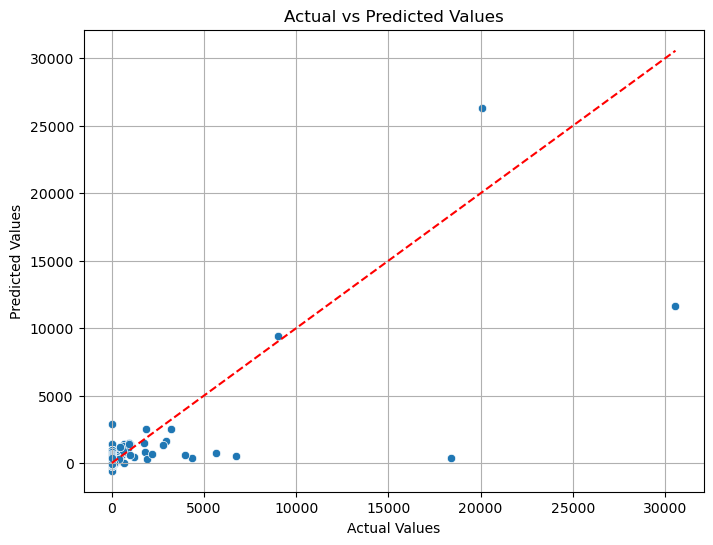

In [53]:
best_model = Pipeline(steps=[('preprocessor', preprocessor),
                              ('regressor', LinearRegression())])
best_model.fit(X_train, y_train)
y_pred_final = best_model.predict(X_test)

plt.figure(figsize=(8, 6))
sns.scatterplot(x=y_test, y=y_pred_final)
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'r--')
plt.title('Actual vs Predicted Values')
plt.xlabel('Actual Values')
plt.ylabel('Predicted Values')
plt.grid()
plt.show()

In [54]:
with open("linear_model.pkl", "wb") as f:
    pickle.dump(best_model, f)